# **Step 1: Import Libraries**

In [3]:
!pip install scikit-optimize

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.8/107.8 kB 2.7 MB/s eta 0:00:00


In [4]:
# Standard library imports
from collections import defaultdict

# Third-party general imports
import numpy as np
import pandas as pd
from scipy import stats

# Visualization imports
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns

# Scikit-learn model selection and evaluation
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import recall_score, precision_score, f1_score, precision_recall_curve, roc_auc_score, confusion_matrix, classification_report, auc, average_precision_score, make_scorer

# Scikit-learn preprocessing and models
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB

# Imbalanced-learn imports
from imblearn.pipeline import Pipeline, make_pipeline
from imblearn.over_sampling import SMOTE, RandomOverSampler, BorderlineSMOTE, ADASYN
from imblearn.under_sampling import TomekLinks, RandomUnderSampler
from imblearn.combine import SMOTETomek

# Gradient boosting frameworks
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

# Bayesian optimization
from skopt import BayesSearchCV
from skopt.space import Real, Integer, Categorical

# Google Colab specific
from google.colab import drive

# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# **Step 2: Read Dataset**

In [5]:
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
df = pd.read_csv('/content/drive/MyDrive/sample.csv', index_col=0).reset_index(drop=True)

In [7]:
pd.set_option('display.max_columns', None)
df.head()

,po_nbr,present_inv,lead_time,total_whpk_qty,fcst_3_mo,fcst_6_mo,fcst_9_mo,sls_1_mo,sls_3_mo,sls_6_mo,sls_9_mo,minimum_stock_qty,identified_defect,spare_parts_overdue,avg_ratings_6_mo,avg_ratings_12_mo,stock_overdue,internal_risk1,internal_risk2,production_quality_risk,pdt_recsys,internal_risk3,out_of_stock
0,2842257,415.0,NaN,0.0,0.0,0.0,0.0,0.0,3.0,28.0,33.0,0.0,No,0.0,-99.00,-99.00,0.0,Yes,No,No,No,No,No
1,3043795,10.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,0.0,0.00,0.05,0.0,Yes,No,No,Yes,No,No
2,1950252,71.0,8.0,6.0,100.0,140.0,160.0,14.0,35.0,71.0,146.0,22.0,No,0.0,0.93,0.94,0.0,No,No,No,Yes,No,No
3,1828636,5.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,0.0,0.99,0.96,0.0,No,No,No,Yes,No,No
4,1312565,63.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,24.0,28.0,1.0,No,0.0,0.69,0.40,0.0,Yes,No,No,Yes,No,No


*   **po_nbr**: Purchase order number
*   **present_inv**: Current inventory levels
*   **lead_time:** Estimated lead time to restock
*   **total_whpk_qty:** Total quantity at warehouse or packaging
*   **fcst_3_mo, fcst_6_mo, fcst_9_mo:** Sales forecasts for the next 3, 6, and 9 months
*   **sls_1_mo, sls_3_mo, sls_6_mo, sls_9_mo:** Actual sales for the next 1, 3, 6, and 9 months
*   **minimum_stock_qty:** Minimum quantity required to avoid a stock-out
*   **identified_defect:** Whether a defect has been identified in the item
*   **spare_parts_overdue:** Indicates delays or backlog for required spare parts
*   **avg_ratings_6_mo, avg_ratings_12_mo:** Average customer ratings in the past 6 and 12 months.
*   **stock_overdue:** Overdue stock count
*   **internal_risk1, internal_risk2, internal_risk3, production_quality_risk:** various risk assessments
*   **pdt_recsys**: Possibly a flag from a product recommendation system (e.g., "recommended to stock this")
*   **out_of_stock**: target column









# **Step 3: Dataset Univariate Analysis**

### Basic Dataset Information
- The dataset contains <b>192994</b> rows (unique purchase orders) and <b>23</b> columns
- 15 columns are <b>float64</b>, 7 columns are <b>object</b>
- <b>Missing values</b> for "lead_time" (6.05% missing data)
- <b>Zero duplicated</b> rows
- <b>Skewed distribution</b> for "present_inv", "total_whpk_qty", "fcst_3_mo", "fcst_6_mo", "fcst_9_mo", "sls_1_mo" , "sls_3_mo", "sls_6_mo", "sls_9_mo" "minimum_stock_qty", "spare_parts_overdue", "stock_overdue", possibly due to having many zeros
- "avg_ratings_6_mo" and "avg_ratings_12_mo" <b>have negative values</b>, which do not make sense
- Target variable is <b>highly imbalanced</b> (No: <i>179953</i>, Yes: <i>1364</i>)
- Many variables have <b>strong correlation</b> with each other
- "po_nbr" is a <b>unique identifier</b>

In [8]:
!pip install ydata-profiling
from pandas_profiling import ProfileReport

profile = ProfileReport(df)
profile

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 14.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 26.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 2.3 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=7e7e55bd56134a190ff3ba5a60ab462a5ec30cb1d3598edbec17ae0a08570f4a
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 23/23 [00:06<00:00,  3.29it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **Step 4: Data Cleaning**

In [13]:
numerical_cols = df.select_dtypes('float64').columns
categorical_cols = df.select_dtypes('object').columns

### Noise Treatment
- <b>avg_ratings_6_mo</b> and <b>avg_ratings_9_mo</b> have negtive values, which include <i>-99</i>.
- We assume that average ratings cannot be negative, so we treat it as bad ratings and replace with 0.
- Do not drop those rows because they consists of 7.7% of the total dataset.

In [14]:
len(df[(df["avg_ratings_6_mo"] == -99) | (df["avg_ratings_12_mo"] == -99)]) / len(df) * 100

7.713193156263926

In [15]:
df['avg_ratings_6_mo'].loc[df['avg_ratings_6_mo'] < 0] = 0
df['avg_ratings_12_mo'].loc[df['avg_ratings_12_mo'] < 0] = 0

print(f"Number of negative values (6 months): {len(df[df['avg_ratings_6_mo'] < 0])}")
print(f"Number of negative values (12 months): {len(df[df['avg_ratings_12_mo'] < 0])}")

Number of negative values (6 months): 0
Number of negative values (12 months): 0


### Outlier Treament

- Use <u>Inter Quartile Range (IQR)</u> method, where data points that are outside the lower bound or upper bound will be considered as outliers.
- Use <u>Log Transformation</u> method to identify the outlier threshold for columns like <b>total_whpk_qty</b>, <b>spare_parts_overdue</b>, and <b>stock_overdue</b> (because IQR method will turn all rows to zero).
- Some columns still have very high skewness but they are reduced significantly from the intial one (do not further pre-process to prevent loss of information)

1. IQR Method

In [16]:
print('Number of outliers:')
iqr_col = numerical_cols.drop(['total_whpk_qty', 'spare_parts_overdue', 'stock_overdue'])
outliers_count = {}

# Loop over each numerical column
for column in iqr_col:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Count the number of outliers
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    outliers_count[column] = outliers.shape[0]

# Print the number of outliers for each column
for column, count in outliers_count.items():
    print(f"{column}': {count}")

Number of outliers:
present_inv': 29246
lead_time': 4029
fcst_3_mo': 39519
fcst_6_mo': 37976
fcst_9_mo': 37623
sls_1_mo': 34216
sls_3_mo': 33421
sls_6_mo': 33466
sls_9_mo': 33520
minimum_stock_qty': 40761
avg_ratings_6_mo': 21550
avg_ratings_12_mo': 22662


In [17]:
# Clip outliers to the upper and lower bounds
for column in iqr_col:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    df[column] = df[column].clip(lower=lower_bound, upper=upper_bound)

2. Log Transformation

total_whpk_qty:
Skewness before Log Transformation: 125.33778710728915
Skewness after Log Transformation: 2.6447550986648483


spare_parts_overdue:
Skewness before Log Transformation: 280.10009325112236
Skewness after Log Transformation: 11.930320348135746


stock_overdue:
Skewness before Log Transformation: 117.092919533305
Skewness after Log Transformation: 14.414405395313084




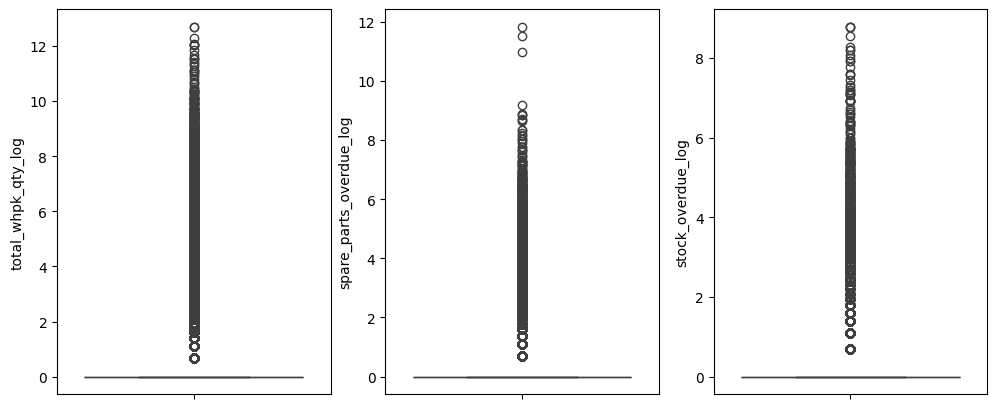

In [18]:
columns = ['total_whpk_qty', 'spare_parts_overdue', 'stock_overdue']
fig, ax = plt.subplots(1,3, figsize=(12,5))
i = 0

for column in columns:
  new_column = column + "_log"
  # Apply Log Transformation (handling zeros by adding 1)
  df[new_column] = np.log1p(df[column])
  skewness_before = df[column].skew()
  skewness_after = df[new_column].skew()
  print(f"{column}:")
  print("Skewness before Log Transformation:", skewness_before)
  print("Skewness after Log Transformation:", skewness_after)
  print("\n")
  sns.boxplot(df[new_column], ax=ax[i])
  i+=1

In [20]:
numerical_columns = df.select_dtypes('float').columns.drop(['total_whpk_qty', 'spare_parts_overdue', 'stock_overdue'])

# Check skewness for numerical columns
for column in numerical_columns:

    skewness = df[column].skew()
    print(f"{column}: {skewness}")

    if skewness < -1 or skewness > 1:
        print("The distribution is highly skewed.")
    elif skewness < -0.5 or skewness > 0.5:
        print("The distribution is moderately skewed.")
    else:
        print("The distribution is approximately symmetric.")
    print('-'*100)

present_inv: 1.192704818142806
The distribution is highly skewed.
----------------------------------------------------------------------------------------------------
lead_time: 0.10105868243521991
The distribution is approximately symmetric.
----------------------------------------------------------------------------------------------------
fcst_3_mo: 1.1760265877261182
The distribution is highly skewed.
----------------------------------------------------------------------------------------------------
fcst_6_mo: 1.178506198095985
The distribution is highly skewed.
----------------------------------------------------------------------------------------------------
fcst_9_mo: 1.1789403184243716
The distribution is highly skewed.
----------------------------------------------------------------------------------------------------
sls_1_mo: 1.148441048624651
The distribution is highly skewed.
------------------------------------------------------------------------------------------------

### Missing Values Treatment
- 6.05% of total values are missing for <b>lead_time</b>
- Impute with the <u>median</u> value

In [21]:
print(f'Before treament: {df["lead_time"].isnull().sum()}')
df['lead_time'] = df['lead_time'].fillna(df['lead_time'].median())
print(f'After treatment: {df["lead_time"].isnull().sum()}')

Before treament: 11677
After treatment: 0


# **Step 5: Bivariate Analysis**
In this section, we will study the relationship of each independent variable with the <b>target variable</b>.

In [22]:
# Set styling
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['figure.figsize'] = (10, 6)
colors = sns.color_palette("muted")

### Heatmap Insights
- "fcst_3_mo", "fcst_6_mo", "fcst_9_mo" show very <b>strong positive correlation</b> with each other --> <i>Sales in one period are highly related to sales in other periods.</i>
- "sls_3_mo", "sls_6_mo", "sls_9_mo" show <b>strong positive correlations</b> with each other --> <i>Forecasts for different time periods are also highly related.</i>
- <b>Moderate positive correlation</b> between Forecasts and Sales (ranging from 0.61 to 0.76) --> <i>Higher forecasts tend to be associated with higher sales</i>
- "present_inv" has <b>moderate negative correlations</b> with Sales and Forecasts --> <i>Present inventory increase, sales and forecasts tend to decrease</i>
- "minimum_stock_qty" has <b>strong positive correlation</b> with Sales and <b>moderate positive correlation</b> with Forecasts --> <i>Minimum stock quantity is higher, sales tend to be higher</i>
- "lead_time", "spare_parts_overdue", "avg_ratings_6_mo", "avg_ratings_12_mo" and "stock_overdue" show relatively <b>weak correlations</b> with most other features --> <i>Have little linear relationship with the other variables</i>

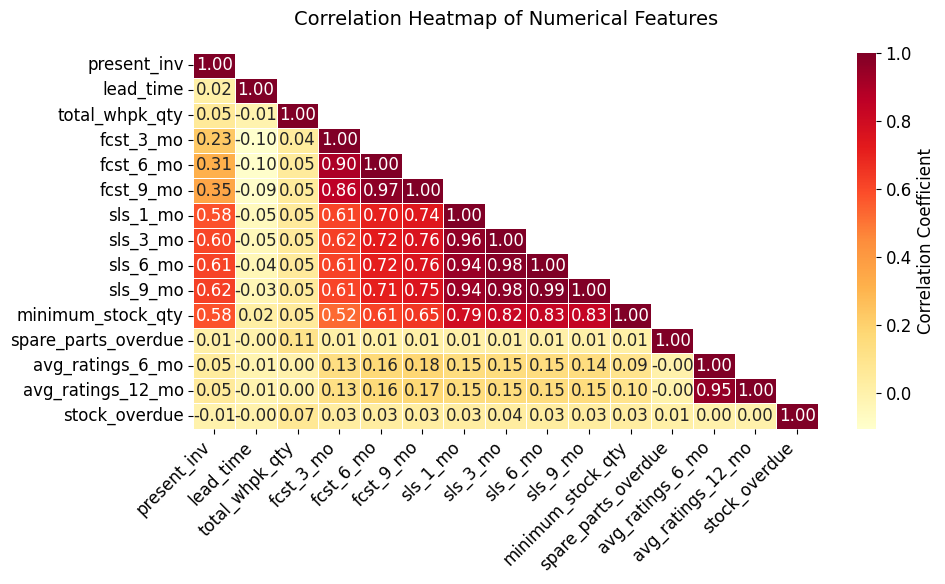

In [23]:
# Correlation Heatmap
plt.figure()
corr = df[numerical_cols].corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask,1)] = True
sns.heatmap(corr, mask=mask, annot=True, cmap='YlOrRd', fmt='.2f', linewidths=0.5,
            cbar_kws={'label': 'Correlation Coefficient'})
plt.title('Correlation Heatmap of Numerical Features', pad=20)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

### Categorical vs Out of Stock
- <b>identified_defect:</b> Having identified defects greatly increases the likelihood of an item being "Out of Stock" --> <i>Significant</i>
- <b>internal_risk1:</b> Does not appear to be a strong predictor --> <i>Significant</i>
- <b>internal_risk2:</b> Might have a moderate impact on the "Out of Stock" status --> <i>Significant</i>
- <b>production_quality_risk:</b> Does not appear to be a strong predictor --> <i>Significant</i>
- <b>pdt_recsys:</b> Does not appear to be a strong predictor --> <i>Not significant</i>
- <b>interal_risk3:</b> Might have a moderate impact on the "Out of Stock" status --> <i>Not significant</i>

In [24]:
cat_cols = categorical_cols.drop("out_of_stock")

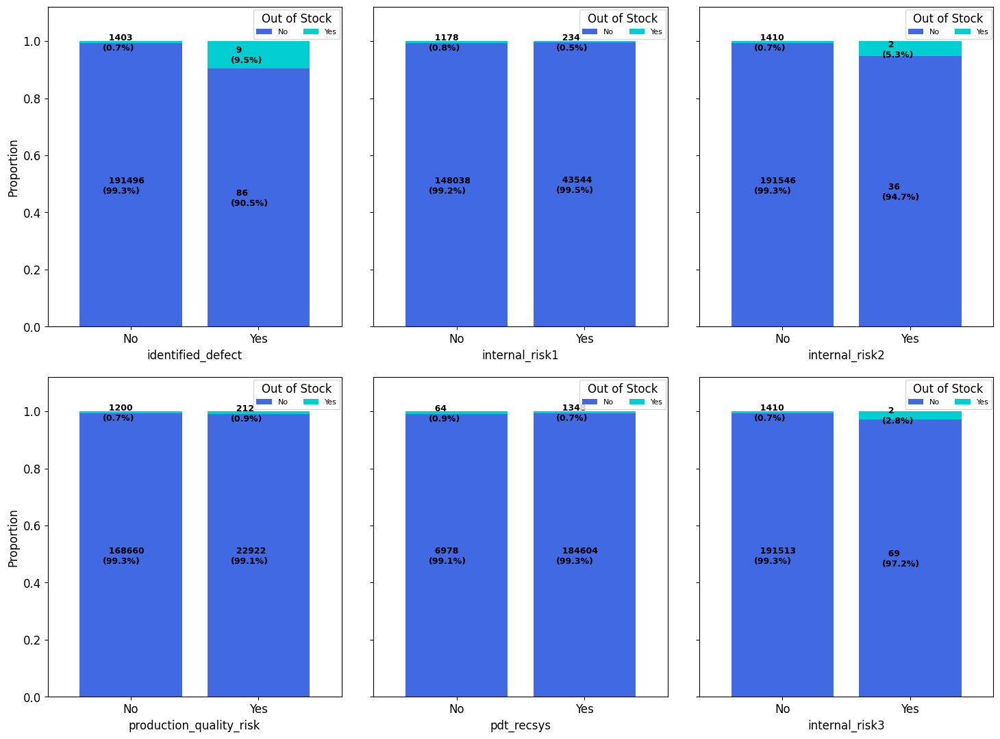

In [25]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(15,11), dpi=100)

for i,col in enumerate(cat_cols):

    # Create a cross tabulation showing the proportion of purchased and non-purchased loans for each category of the feature
    cross_tab = pd.crosstab(index=df[col], columns=df['out_of_stock'])

    # Using the normalize=True argument gives us the index-wise proportion of the data
    cross_tab_prop = pd.crosstab(index=df[col], columns=df['out_of_stock'], normalize='index')

    # Define colormap
    cmp = ListedColormap(['royalblue', 'darkturquoise'])

    # Plot stacked bar charts
    x, y = i//3, i%3
    cross_tab_prop.plot(kind='bar', ax=ax[x,y], stacked=True, width=0.8, colormap=cmp,
                        legend=False, ylabel='Proportion', sharey=True)

    # Add the proportions and counts of the individual bars to our plot
    for idx, val in enumerate([*cross_tab.index.values]):
        for (proportion, count, y_location) in zip(cross_tab_prop.loc[val],cross_tab.loc[val],cross_tab_prop.loc[val].cumsum()):
            ax[x,y].text(x=idx-0.22, y=(y_location-proportion)+(proportion/2)-0.03,
                         s = f'  {count}\n({np.round(proportion * 100, 1)}%)',
                         color = "black", fontsize=9, fontweight="bold")

    # Add legend
    ax[x,y].legend(title='Out of Stock', loc=(0.7,0.9), fontsize=8, ncol=2)
    # Set y limit
    ax[x,y].set_ylim([0,1.12])
    # Rotate xticks
    ax[x,y].set_xticklabels(ax[x,y].get_xticklabels(), rotation=0)

plt.tight_layout()
plt.show()

In [26]:
import pandas as pd
from scipy.stats import chi2_contingency

def test_categorical_significance(df, categorical_variable, target_variable='out_of_stock', alpha=0.05):

    contingency_table = pd.crosstab(df[categorical_variable], df[target_variable])
    chi2, p, dof, expected = chi2_contingency(contingency_table)

    if p < alpha:
        return categorical_variable, chi2, p, True
    else:
        return categorical_variable, chi2, p, False


results = []
for col in cat_cols:
    result = test_categorical_significance(df, col) # Replace 'your_dataframe' with your actual DataFrame name
    results.append(result)

# You can further analyze the 'results' list if needed
print("\nSummary of Significance:")
for var, chi2, p, significant in results:
    print(f"- {var}: {'Significant' if significant else 'Not Significant'} (p-value = {p:.4f})")


Summary of Significance:
- identified_defect: Significant (p-value = 0.0000)
- internal_risk1: Significant (p-value = 0.0000)
- internal_risk2: Significant (p-value = 0.0200)
- production_quality_risk: Significant (p-value = 0.0005)
- pdt_recsys: Not Significant (p-value = 0.0879)
- internal_risk3: Not Significant (p-value = 0.1720)


### Numerical vs Out of Stock

- <b>Low Current Inventory is a Major Risk Factor:</b> Items with significantly lower current inventory are much more likely to go out of stock.
- <b>High Forecasted Demand Correlates with Stockouts:</b> Higher forecasts for the next 3, 6, and 9 months are associated with a higher likelihood of being out of stock. This suggests potential underestimation of demand or insufficient stocking despite anticipated high demand.
- <b>Higher Recent Sales Lead to Stockouts:</b> Items with higher sales in the past 1, 3, 6, and 9 months are more prone to stockouts, indicating that strong recent demand might be depleting inventory faster than replenishment.
- <b>Overdue Stock is a Weak Indicator of Stockouts:</b> A higher amount of overdue stock is slightly associated with items going out of stock, likely reflecting inefficiencies in inventory management or supply chain issues.
- <b>Lead Time and Minimum Stock Quantity Show Less Clear Patterns:</B> lead_time and minimum_stock_qty do not show a strong differentiating pattern between items that went out of stock and those that did not.
- <b>Slightly Lower Ratings for Out-of-Stock Items:</b> Items that went out of stock tend to have slightly lower average ratings over the past 6 and 12 months, which might suggest customer dissatisfaction due to stock unavailability or other related issues.
- <b>Total Warehouse Pick Quantity is Lower for Out-of-Stock Items:</b> Items with a lower total warehouse pick quantity are more likely to be out of stock, potentially indicating lower overall movement or perhaps issues in the picking process contributing to stockouts.
- <b>More Overdue Spare Parts Linked to Stockouts:</b> A higher number of overdue spare parts is associated with a higher chance of being out of stock, potentially indicating broader supply chain or management challenges.
- There are <b>significant differences</b> between all numerical variables and the target variable except for minimum_stock_qty



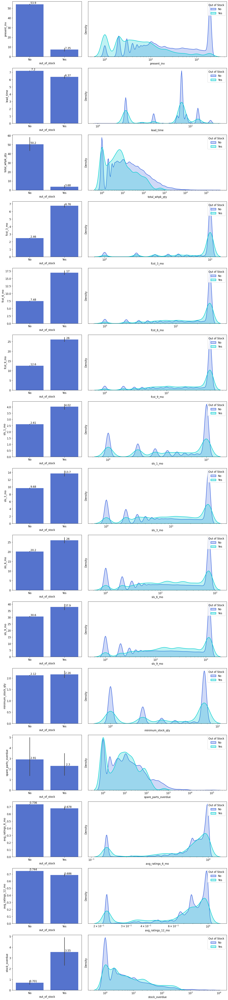

In [27]:
sns.set_palette(['royalblue', 'darkturquoise'])

fig, ax = plt.subplots(15, 2, figsize=(15,65), gridspec_kw={'width_ratios': [1, 2]})

for i,col in enumerate(numerical_cols):
    numerical_positive = df[df[col] > 0]
    graph = sns.barplot(data=df, x='out_of_stock', y=col, ax=ax[i,0])
    sns.kdeplot(data=numerical_positive[numerical_positive['out_of_stock']=='No'], x=col, fill=True, linewidth=2, ax=ax[i,1], log_scale=True, bw_adjust=0.5)
    sns.kdeplot(data=numerical_positive[numerical_positive['out_of_stock']=='Yes'], x=col, fill=True, linewidth=2, ax=ax[i,1], log_scale=True, bw_adjust=0.5)
    ax[i,1].set_yticks([])
#     ax[i,1].legend(title='Out of Stock', loc='upper right')
    ax[i,1].legend(['No', 'Yes'], title='Out of Stock', loc='upper right')
    # Add bar sizes to our plot
    for cont in graph.containers:
        graph.bar_label(cont, fmt='         %.3g')

plt.tight_layout()
plt.show()

In [28]:
"""
Given that the distributions in the KDE plots appear skewed (violating the normality assumption required for t-tests), we will use non-parametric tests like the Mann-Whitney U test to compare the distributions.
"""

alpha = 0.05  # Significance level

for col in numerical_cols:
    group_no = df[df['out_of_stock'] == 'No'][col]
    group_yes = df[df['out_of_stock'] == 'Yes'][col]

    # Perform Mann-Whitney U test
    statistic, p_value = stats.mannwhitneyu(group_no, group_yes, alternative='two-sided')

    print(f"P-value for: {col} --> {p_value:.3f}")

    if p_value < alpha:
        print(f"  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distribution of {col} between out-of-stock and not out-of-stock items.\n")
    else:
        print(f"  Fail to Reject Null Hypothesis: There is NO SIGNIFICANT DIFFERENCE in the distribution of {col} between out-of-stock and not out-of-stock items.\n")

P-value for: present_inv --> 0.000
  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distribution of present_inv between out-of-stock and not out-of-stock items.

P-value for: lead_time --> 0.000
  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distribution of lead_time between out-of-stock and not out-of-stock items.

P-value for: total_whpk_qty --> 0.000
  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distribution of total_whpk_qty between out-of-stock and not out-of-stock items.

P-value for: fcst_3_mo --> 0.000
  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distribution of fcst_3_mo between out-of-stock and not out-of-stock items.

P-value for: fcst_6_mo --> 0.000
  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distribution of fcst_6_mo between out-of-stock and not out-of-stock items.

P-value for: fcst_9_mo --> 0.000
  Reject Null Hypothesis: There is a SIGNIFICANT DIFFERENCE in the distri

# **Step 6: Feature Encoding**

### Convert target column to 0 and 1

In [29]:
df['out_of_stock'] = df['out_of_stock'].replace({'Yes':1, 'No':0})

### Convert categorical variables to numerical variables using pd.get_dummies

In [30]:
# Identifying categorical columns (assuming non-numeric columns are categorical)
cat_cols = df.select_dtypes(include='object').columns

# Applying one-hot encoding to the categorical columns
df = pd.get_dummies(df, columns=cat_cols, drop_first=True)

# Dropping the purchase id number column
df = df.drop('po_nbr', axis=1)

# **Step 7: Train Test Split**

In [31]:
X = df.drop(['out_of_stock'], axis=1)
y = df['out_of_stock']


X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.20, shuffle=True, random_state=40, stratify=y)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(154395, 24)
(154395,)
(38599, 24)
(38599,)


# **Step 8: Selecting The Best Model (Using Imbalanced Dataset)**

- Test 7 different models (with random parameters) on imbalanced dataset to select the top 3 baseline models.
- Choose top 3 models based on <b>area under precision-recall curve (AUPRC)</b>as baseline models: <i>Deicision Tree</i>, <i>Random Forest</i>, and <i>XGBoost</i>.
- Decide on the best classification thresholds (highest F1 score) for each model after selecting the best sampling technique in the next section.

In [ ]:
models = {
    "Logistic Regression": LogisticRegression(penalty='l2', C=0.5),
    "Decision Tree": DecisionTreeClassifier(criterion='gini', max_depth=10, min_samples_split=50, min_samples_leaf=20, class_weight='balanced', random_state=42),
    "Random Forest": RandomForestClassifier(n_estimators=300, criterion='gini', max_depth=10, min_samples_split=50, min_samples_leaf=20, class_weight='balanced', random_state=42),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5, weights='uniform', algorithm='auto', metric='minkowski'),
    "Naive Bayes": BernoulliNB(alpha=0.5),
    "XGboost": XGBClassifier(learning_rate=0.01, max_depth=10, subsample=0.8, colsample_bytree=0.8, reg_lambda=0.5, use_label_encoder=False, eval_metric='logloss', random_state=42, verbosity=0),
    "LightGBM": LGBMClassifier(learning_rate=0.01, num_leaves=15, max_depth=10, min_child_samples=100, subsample=0.9, colsample_bytree=0.7, is_unbalance=True, verbose=-1)
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

scoring = ['recall', 'precision', 'f1', 'average_precision']

In [ ]:
pd.set_option('display.max_rows', None)        # Show all rows
pd.set_option('display.max_columns', None)     # Show all columns
pd.set_option('display.width', 1000)           # Adjust display width to fit columns

# Define thresholds to test
thresholds_to_test = np.arange(0.1, 1.05, 0.05) # e.g., 0.1, 0.15, ..., 0.85

all_cv_results = [] # To store results for all models, all folds, all thresholds

print("Evaluating Models at Different Classification Thresholds using Cross-Validation:")
print("----------------------------------------------------------------------------------")

for model_name, model_instance in models.items():
    print(f"\n--- Evaluating Model: {model_name} ---")

    fold_metrics_at_thresholds = defaultdict(lambda: defaultdict(list))

    # We use StratifiedKFold manually to get predictions per fold
    for fold, (train_index, val_index) in enumerate(stratified_kfold.split(X_train_scaled, y_train)):
        X_train_fold, X_val_fold = X_train_scaled.iloc[train_index], X_train_scaled.iloc[val_index]
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

        # Train the model on the current fold's training data
        current_model = model_instance # Create a new instance for each fold if model state matters
        # Some models might need re-initialization if they carry state or fit on partial data
        # For tree-based models and LogisticRegression, typically a new fit is sufficient.
        if 'random_state' in current_model.get_params(): # Ensure reproducibility for models with random_state
            current_model.set_params(random_state=42)

        current_model.fit(X_train_fold, y_train_fold)

        # Get probability predictions on the current fold's validation set
        y_pred_proba_val = current_model.predict_proba(X_val_fold)[:, 1]

        # Evaluate performance for each threshold
        for threshold in thresholds_to_test:
            y_pred_threshold = (y_pred_proba_val >= threshold).astype(int)

            report = classification_report(y_val_fold, y_pred_threshold, output_dict=True, zero_division=0)

            # Ensure '1' class exists in report, otherwise metrics might be missing
            precision_val = report['1']['precision'] if '1' in report else 0.0
            recall_val = report['1']['recall'] if '1' in report else 0.0
            f1_val = report['1']['f1-score'] if '1' in report else 0.0

            # For AUPRC, calculate based on probabilities, not thresholded predictions
            precision_pr, recall_pr, _ = precision_recall_curve(y_val_fold, y_pred_proba_val)
            auprc_val = auc(recall_pr, precision_pr)

            fold_metrics_at_thresholds[threshold]['precision'].append(precision_val)
            fold_metrics_at_thresholds[threshold]['recall'].append(recall_val)
            fold_metrics_at_thresholds[threshold]['f1_score'].append(f1_val)
            fold_metrics_at_thresholds[threshold]['auprc'].append(auprc_val)

    # After all folds for the current model, aggregate results per threshold
    for threshold, metrics in fold_metrics_at_thresholds.items():
        avg_precision = np.mean(metrics['precision'])
        avg_recall = np.mean(metrics['recall'])
        avg_f1_score = np.mean(metrics['f1_score'])
        avg_auprc = np.mean(metrics['auprc']) # AUPRC remains constant per model/fold for a set of probabilities

        all_cv_results.append([
            model_name,
            threshold,
            avg_precision,
            avg_recall,
            avg_f1_score,
            avg_auprc
        ])

# Create a DataFrame from all collected results
results_df_all_thresholds = pd.DataFrame(all_cv_results,
                                         columns=['Model', 'Threshold', 'Avg Precision', 'Avg Recall', 'Avg F1 Score', 'Avg AUPRC'])

# Sort by AUPRC to easily see overall best models, then by threshold
results_df_all_thresholds = results_df_all_thresholds.sort_values(by=['Model', 'Threshold'], ascending=[True, True])


print("\n--- Summary of Cross-Validation Results Across Models and Thresholds ---")
print(results_df_all_thresholds)

# Optional: Print results for a specific threshold, e.g., 0.7
print("\n--- Results at Threshold 0.7 ---")
print(results_df_all_thresholds[results_df_all_thresholds['Threshold'] == 0.7].sort_values(by='Avg AUPRC', ascending=False))

Evaluating Models at Different Classification Thresholds using Cross-Validation:
----------------------------------------------------------------------------------

--- Evaluating Model: Logistic Regression ---

--- Evaluating Model: Decision Tree ---

--- Evaluating Model: Random Forest ---

--- Evaluating Model: K-Nearest Neighbors ---

--- Evaluating Model: Naive Bayes ---

--- Evaluating Model: XGboost ---

--- Evaluating Model: LightGBM ---

--- Summary of Cross-Validation Results Across Models and Thresholds ---
                   Model  Threshold  Avg Precision  Avg Recall  Avg F1 Score  Avg AUPRC
19         Decision Tree       0.10       0.038204    0.781416      0.072801   0.170930
20         Decision Tree       0.15       0.041008    0.779646      0.077915   0.170930
21         Decision Tree       0.20       0.041773    0.778761      0.079286   0.170930
22         Decision Tree       0.25       0.042298    0.776991      0.080220   0.170930
23         Decision Tree       0.30 

# **Step 9: Selecting The Best Sampling Technique**

- <b>XGBoost</b> with <b>class weights</b> is selected because they show the highest F1 score and AUPRC
- Oversampling techniques (<i>SMOTE, SMOTE + TOMEK, Random Oversampling</i>) seem to make XGBoost (and even Random Forest) too aggressive, leading to very poor precision and F1 scores.

In [47]:
baseline_models = {
    "Random Forest": RandomForestClassifier(n_estimators=200, criterion='gini', max_depth=10, min_samples_split=50, min_samples_leaf=20, random_state=42),
    "LightGBM": LGBMClassifier(learning_rate=0.001, num_leaves=15, max_depth=10, min_child_samples=100, subsample=0.9, colsample_bytree=0.7, random_state=42, n_estimators=200, objective='binary', verbose=-1),
    "XGBoost": XGBClassifier(learning_rate=0.001, max_depth=10, subsample=0.8, colsample_bytree=0.8, reg_lambda=0.5, use_label_encoder=False, eval_metric='logloss', random_state=42, verbosity=0)
}
scoring = {'recall_score': 'recall', 'precision_score': 'precision', 'f1_score': 'f1', 'precision_recall_score': 'average_precision'}
stratified_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

### **Class Weights**
- Balances Imbalance Without Resampling: Adjusts model loss function to penalize misclassifications of the minority class more heavily.

- Built into Many Models: Supported natively

- Memory-Efficient: No data duplication/deletion needed—ideal for large datasets.

In [51]:
neg_count = (y_train == 0).sum()
pos_count = (y_train == 1).sum()
scale_pos_weight_value = neg_count / pos_count

baseline_models_cw = {
    "Random Forest": RandomForestClassifier(n_estimators=200, criterion='gini', max_depth=10, min_samples_split=50, min_samples_leaf=20, class_weight='balanced', random_state=42),
    "LightGBM": LGBMClassifier(learning_rate=0.001, num_leaves=15, max_depth=10, min_child_samples=100, subsample=0.9, colsample_bytree=0.7, random_state=42, n_estimators=200, objective='binary', verbose=-1, is_unbalance=True),
    "XGBoost": XGBClassifier(learning_rate=0.001, max_depth=10, subsample=0.8, colsample_bytree=0.8, reg_lambda=0.5, use_label_encoder=False, eval_metric='logloss', random_state=42, verbosity=0, scale_pos_weight=scale_pos_weight_value)
}

cw_score = []

for model_name, model_instance in baseline_models_cw.items():
    score = cross_validate(model_instance, X_train_scaled, y_train, cv=stratified_kfold, scoring=scoring, return_train_score = True)

    recall_mean = score['test_recall_score'].mean() # Note: changed from test_recall_score to test_recall as per standard scoring keys
    precision_mean = score['test_precision_score'].mean() # Note: changed from test_precision_score to test_precision
    f1_mean = score['test_f1_score'].mean() # Note: changed from test_f1_score to test_f1
    pr_auc_mean = score['test_precision_recall_score'].mean() # Note: changed from test_precision_recall_score to test_average_precision

    # Append the results for the current model as a dictionary to the list
    cw_score.append({
        'Model': model_name,
        'Sampling Technique': 'Class Weights', # Or 'No Under/Oversampling' if this is your initial baseline
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean
    })

# Create the final DataFrame after the loop
cw_score_df = pd.DataFrame(cw_score)

cw_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,Class Weights,0.770795,0.06366,0.117580,0.164776
1,LightGBM,Class Weights,0.000000,0.00000,0.000000,0.137932
2,XGBoost,Class Weights,0.734494,0.07167,0.130564,0.165995


### **Random Undersampling**
- Drops Majority Samples: Randomly removes instances from the majority class to match the minority class size.

- Loss of Information: Risks discarding useful data, especially if the majority class is large.

- Computationally Efficient: Reduces dataset size, speeding up training.

In [52]:
ru_score = [] # Use a new list name for undersampling results

for model_name, model_instance in baseline_models.items():
    # Create a pipeline with StandardScaler, RandomUnderSampler, and the model instance
    # RandomUnderSampler will reduce the majority class
    ru_pipeline = make_pipeline(StandardScaler(), RandomUnderSampler(random_state=42), model_instance)

    # Perform cross-validation with the undersampling pipeline
    score = cross_validate(ru_pipeline, X_train, y_train, cv=stratified_kfold, scoring=scoring, return_train_score=True)

    # Correcting the access keys for scores (as discussed previously)
    recall_mean = score['test_recall_score'].mean()
    precision_mean = score['test_precision_score'].mean()
    f1_mean = score['test_f1_score'].mean()
    pr_auc_mean = score['test_precision_recall_score'].mean()

    # Append the results for the current model as a dictionary to the list
    ru_score.append({
        'Model': model_name,
        'Sampling Technique': 'Random Undersampling', # Change the sampling technique name
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean
    })

# Create the final DataFrame after the loop
ru_score_df = pd.DataFrame(ru_score)

ru_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,Random Undersampling,0.853991,0.034749,0.066777,0.125697
1,LightGBM,Random Undersampling,0.829209,0.032752,0.063013,0.114512
2,XGBoost,Random Undersampling,0.887625,0.040487,0.077440,0.120042


### **Random Oversampling**

- Replicates Minority Samples: Randomly duplicates minority-class instances to balance the dataset.

- Simple but Risky: Can cause overfitting since it copies existing data without adding new information.

- Fast & Baseline-Friendly: Easy to implement as a first-step solution for mild imbalance.

In [53]:
ro_score = []

for model_name, model_instance in baseline_models.items():
    ro_pipeline = make_pipeline(StandardScaler(), RandomOverSampler(random_state=42), model_instance)
    score = cross_validate(ro_pipeline, X_train, y_train, cv=stratified_kfold, scoring=scoring, return_train_score = True)

    recall_mean = score['test_recall_score'].mean() # Note: changed from test_recall_score to test_recall as per standard scoring keys
    precision_mean = score['test_precision_score'].mean() # Note: changed from test_precision_score to test_precision
    f1_mean = score['test_f1_score'].mean() # Note: changed from test_f1_score to test_f1
    pr_auc_mean = score['test_precision_recall_score'].mean() # Note: changed from test_precision_recall_score to test_average_precision

    # Append the results for the current model as a dictionary to the list
    ro_score.append({
        'Model': model_name,
        'Sampling Technique': 'Random Oversampling', # Or 'No Under/Oversampling' if this is your initial baseline
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean
    })

# Create the final DataFrame after the loop
ro_score_df = pd.DataFrame(ro_score)

ro_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,Random Oversampling,0.797341,0.057248,0.106807,0.165431
1,LightGBM,Random Oversampling,0.869022,0.040741,0.077832,0.119944
2,XGBoost,Random Oversampling,0.732714,0.065370,0.120016,0.165024


### **SMOTE (Synthetic Minority Oversampling Technique)**

- Synthetic Oversampling: Generates artificial minority-class samples by interpolating between existing ones to balance the dataset.

- Mitigates Class Imbalance: Helps prevent models from being biased toward the majority class by creating diverse synthetic examples.

In [54]:
smt_score = []

for model_name, model_instance in baseline_models.items():
    smt_pipeline = make_pipeline(StandardScaler(), SMOTE(random_state=42), model_instance)
    score = cross_validate(smt_pipeline, X_train, y_train, cv=stratified_kfold, scoring=scoring, return_train_score = True)

    recall_mean = score['test_recall_score'].mean() # Note: changed from test_recall_score to test_recall as per standard scoring keys
    precision_mean = score['test_precision_score'].mean() # Note: changed from test_precision_score to test_precision
    f1_mean = score['test_f1_score'].mean() # Note: changed from test_f1_score to test_f1
    pr_auc_mean = score['test_precision_recall_score'].mean() # Note: changed from test_precision_recall_score to test_average_precision

    # Append the results for the current model as a dictionary to the list
    smt_score.append({
        'Model': model_name,
        'Sampling Technique': 'SMOTE', # Or 'No Under/Oversampling' if this is your initial baseline
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean
    })

# Create the final DataFrame after the loop
smt_score_df = pd.DataFrame(smt_score)

smt_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,SMOTE,0.721215,0.063472,0.116614,0.142967
1,LightGBM,SMOTE,0.827443,0.046911,0.088788,0.119806
2,XGBoost,SMOTE,0.630978,0.074609,0.133291,0.129597


### **SMOTE + Tomek Links**
- Hybrid Approach: Combines SMOTE (oversamples the minority class) with Tomek Links (cleans noisy majority-class samples near the boundary).

- Better Than SMOTE Alone: Reduces class overlap by removing ambiguous majority samples, improving classifier performance.

In [55]:
smttmk_score = []

for model_name, model_instance in baseline_models.items():
    smttmk_pipeline = make_pipeline(StandardScaler(), SMOTETomek(tomek=TomekLinks(sampling_strategy='majority')), model_instance)
    score = cross_validate(smttmk_pipeline, X_train, y_train, cv=stratified_kfold, scoring=scoring, return_train_score = True)

    recall_mean = score['test_recall_score'].mean() # Note: changed from test_recall_score to test_recall as per standard scoring keys
    precision_mean = score['test_precision_score'].mean() # Note: changed from test_precision_score to test_precision
    f1_mean = score['test_f1_score'].mean() # Note: changed from test_f1_score to test_f1
    pr_auc_mean = score['test_precision_recall_score'].mean() # Note: changed from test_precision_recall_score to test_average_precision

    # Append the results for the current model as a dictionary to the list
    smttmk_score.append({
        'Model': model_name,
        'Sampling Technique': 'SMOTE + TOMEK', # Or 'No Under/Oversampling' if this is your initial baseline
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean
    })

# Create the final DataFrame after the loop
smttmk_score_df = pd.DataFrame(smttmk_score)

smttmk_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,SMOTE + TOMEK,0.720321,0.063211,0.116175,0.141767
1,LightGBM,SMOTE + TOMEK,0.828336,0.047209,0.089326,0.120019
2,XGBoost,SMOTE + TOMEK,0.644243,0.075125,0.134469,0.132912


### **BorderlineSMOTE**

- Smarter SMOTE: Focuses only on borderline minority samples (near the decision boundary) instead of all minority instances.

- Reduces Noise: Generates synthetic samples more carefully, avoiding overgeneralization in overlapping class regions.

- Two Modes: `borderline-1` (aggressive) and `borderline-2` (conservative) for different imbalance scenarios.

In [50]:
bsmote_score = []

for model_name, model_instance in baseline_models.items():
    # Corrected capitalization of BorderlineSMOTE and changed the 'kind' parameter value
    bsmote_pipeline = make_pipeline(StandardScaler(), BorderlineSMOTE(random_state=42, sampling_strategy='auto', k_neighbors=5, m_neighbors=10, kind='borderline-1'), model_instance)
    score = cross_validate(bsmote_pipeline, X_train, y_train, cv=stratified_kfold, scoring=scoring, return_train_score = True)

    recall_mean = score['test_recall_score'].mean()
    precision_mean = score['test_precision_score'].mean()
    f1_mean = score['test_f1_score'].mean()
    pr_auc_mean = score['test_precision_recall_score'].mean()

    # Append the results for the current model as a dictionary to the list
    bsmote_score.append({
        'Model': model_name,
        'Sampling Technique': 'BorderlineSMOTE',
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean
    })

# Create the final DataFrame after the loop
bsmote_score_df = pd.DataFrame(bsmote_score)

bsmote_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,BorderlineSMOTE,0.635377,0.077529,0.138069,0.136412
1,LightGBM,BorderlineSMOTE,0.774336,0.053524,0.100126,0.117843
2,XGBoost,BorderlineSMOTE,0.564559,0.090648,0.156140,0.127447


### **Adasyn**

In [56]:
adasyn_score = []

for model_name, model_instance in baseline_models.items():
    # Create pipeline with ADASYN and the model
    adasyn_pipeline = make_pipeline(StandardScaler(), ADASYN(random_state=42, sampling_strategy='auto', n_neighbors=5), model_instance)

    # Perform cross-validation
    score = cross_validate(adasyn_pipeline, X_train, y_train, cv=stratified_kfold, scoring=scoring, return_train_score=True)

    # Calculate mean scores
    recall_mean = score['test_recall_score'].mean() # Note: changed from test_recall_score to test_recall as per standard scoring keys
    precision_mean = score['test_precision_score'].mean() # Note: changed from test_precision_score to test_precision
    f1_mean = score['test_f1_score'].mean() # Note: changed from test_f1_score to test_f1
    pr_auc_mean = score['test_precision_recall_score'].mean() # Note: changed from test_precision_recall_score to test_average_precision

    # Append the results for the current model
    adasyn_score.append({
        'Model': model_name,
        'Sampling Technique': 'ADASYN',  # Updated to reflect ADASYN
        'Recall': recall_mean,
        'Precision': precision_mean,
        'F1 Score': f1_mean,
        'Precision-Recall Curve': pr_auc_mean  # AUPRC
    })

# Create the final DataFrame
adasyn_score_df = pd.DataFrame(adasyn_score)

# Display the results
adasyn_score_df

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
0,Random Forest,ADASYN,0.730950,0.062589,0.115272,0.137799
1,LightGBM,ADASYN,0.830109,0.046101,0.087349,0.119670
2,XGBoost,ADASYN,0.647777,0.073625,0.131985,0.130625


### **Performance Comparison**

In [61]:
predictions = pd.concat([cw_score_df, ro_score_df, ru_score_df, smt_score_df, smttmk_score_df, bsmote_score_df, adasyn_score_df], ignore_index=True, sort=False)
predictions.sort_values(by=['Precision-Recall Curve'], ascending=False)

,Model,Sampling Technique,Recall,Precision,F1 Score,Precision-Recall Curve
2,XGBoost,Class Weights,0.734494,0.071670,0.130564,0.165995
3,Random Forest,Random Oversampling,0.797341,0.057248,0.106807,0.165431
5,XGBoost,Random Oversampling,0.732714,0.065370,0.120016,0.165024
0,Random Forest,Class Weights,0.770795,0.063660,0.117580,0.164776
9,Random Forest,SMOTE,0.721215,0.063472,0.116614,0.142967
12,Random Forest,SMOTE + TOMEK,0.720321,0.063211,0.116175,0.141767
1,LightGBM,Class Weights,0.000000,0.000000,0.000000,0.137932
18,Random Forest,ADASYN,0.730950,0.062589,0.115272,0.137799
15,Random Forest,BorderlineSMOTE,0.635377,0.077529,0.138069,0.136412
14,XGBoost,SMOTE + TOMEK,0.644243,0.075125,0.134469,0.132912


# **Step 10: Model Building**

### **Optimising for Recall score**

Recall: The ability of a model to find all the relevant cases within a data set. The number of true positives divided by the number of true positives plus the number of false negatives.

In the case of Out Of Stock (OOS) scenario, predicting stock levels accurately is crucial for inventory management and customer satisfaction. Wrong predictions can lead to two types of errors:


*   **False Positives: The model predicts an item will be out of stock, but it's actually in stock.**

Consequences:
1. Overstocking: May lead to unnecessary restocking, resulting in overstock and increased holding costs.
2. Wasted Resources: Resources spent on unnecessary restocking could have been used elsewhere.

*  **False Negatives: The model predicts an item will be in stock, but it's actually out of stock.**

Consequences:
1. Customer Dissatisfaction: Customers expecting an item to be available might be disappointed, potentially harming brand loyalty and customer trust.
2. Lost Sales: Immediate lost revenue from not being able to sell the item.
3. Operational Disruption: Adjusting operations last minute to account for unexpected stockouts can be disruptive and costly.

Since predicting false negatives is more detrimental to the business, we will use recall score as the evaluation metric.


# **Step 11: Hyperparameter Tuning Using BayesSearchCV**

In [35]:
# Calculate the scale_pos_weight dynamically
neg_count = (y_train == 0).sum()
pos_count = (y_train == 1).sum()
scale_pos_weight_value = neg_count / pos_count
print(f"Calculated scale_pos_weight for XGBoost: {scale_pos_weight_value:.2f}\n")

# Define the pipeline for the model
# We'll use a Pipeline from imblearn to properly integrate StandardScaler and XGBoost
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('xgb', XGBClassifier(
        objective='binary:logistic', # Default for binary classification
        eval_metric='logloss',
        use_label_encoder=False,
        random_state=42,
        verbosity=0,
        scale_pos_weight=scale_pos_weight_value # Apply class weights here
    ))
])

# Define the search space for hyperparameters
# Prefix parameters with 'xgb__' because it's part of the 'xgb' step in the pipeline
search_space = {
    'xgb__n_estimators': Integer(50, 500), # Number of boosting rounds
    'xgb__learning_rate': Real(0.01, 0.2, prior='log-uniform'), # Step size shrinkage
    'xgb__max_depth': Integer(3, 15), # Maximum depth of a tree
    'xgb__subsample': Real(0.6, 1.0, prior='uniform'), # Subsample ratio of the training instance
    'xgb__colsample_bytree': Real(0.6, 1.0, prior='uniform'), # Subsample ratio of columns when constructing each tree
    'xgb__gamma': Real(0.0, 0.5, prior='uniform'), # Minimum loss reduction required to make a further partition
    'xgb__reg_alpha': Real(0.0, 1.0, prior='uniform'), # L1 regularization term on weights
    'xgb__reg_lambda': Real(1.0, 5.0, prior='uniform'), # L2 regularization term on weights (already in your initial setup, but can be tuned)
    'xgb__min_child_weight': Integer(1, 10) # Minimum sum of instance weight (hessian) needed in a child
}

# Define the scoring metric for optimization
# AUPRC is the primary metric for model selection
scoring_metric = 'average_precision'

# Set up StratifiedKFold for cross-validation
n_splits = 5
stratified_kfold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Perform Bayesian Optimization
bayes_search = BayesSearchCV(
    estimator=pipeline,
    search_spaces=search_space,
    n_iter=50, # Number of search iterations (increase for more thorough search)
    cv=stratified_kfold,
    scoring=scoring_metric,
    n_jobs=-1, # Use all available CPU cores
    verbose=2, # Verbosity level (2 shows more details)
    random_state=42,
    return_train_score=True # Keep this if you want to inspect train scores
)

# Fit the Bayesian search object to your training data
bayes_search.fit(X_train, y_train)

# --- 8. Print the results ---
print("\n--- Bayesian Optimization Results ---")
print(f"Best AUPRC (Average Precision): {bayes_search.best_score_:.4f}")
print(f"Best Hyperparameters: {bayes_search.best_params_}")

# Get the best trained model
best_xgb_model = bayes_search.best_estimator_
print("\nBest trained XGBoost pipeline obtained from Bayesian Optimization:")
print(best_xgb_model)

y_pred_test = best_xgb_model.predict(X_test)
y_pred_proba_test = best_xgb_model.predict_proba(X_test)[:, 1]

print("\n--- Performance on Test Set (using best model) ---")
print(classification_report(y_test, y_pred_test, zero_division=0))
precision_pr, recall_pr, _ = precision_recall_curve(y_test, y_pred_proba_test)
test_auprc = auc(recall_pr, precision_pr)
print(f"Test Set AUPRC: {test_auprc:.4f}")

Calculated scale_pos_weight for XGBoost: 135.63

Starting Bayesian Optimization for XGBoost...
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for 

# **Step 12: Finding The Most Optimal Threshold**
- The selected threshold is <i>0.3</i> because it has sufficiently high recall score while having a reasonable F1 score.

In [36]:
final_model = best_xgb_model.fit(X_train, y_train)
y_pred_proba_test = final_model.predict_proba(X_test)[:, 1]
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_proba_test)
auprc_test = auc(recalls, precisions)

print(f"\nFinal Model Test Set AUPRC: {auprc_test:.4f}")


Final Model Test Set AUPRC: 0.1624


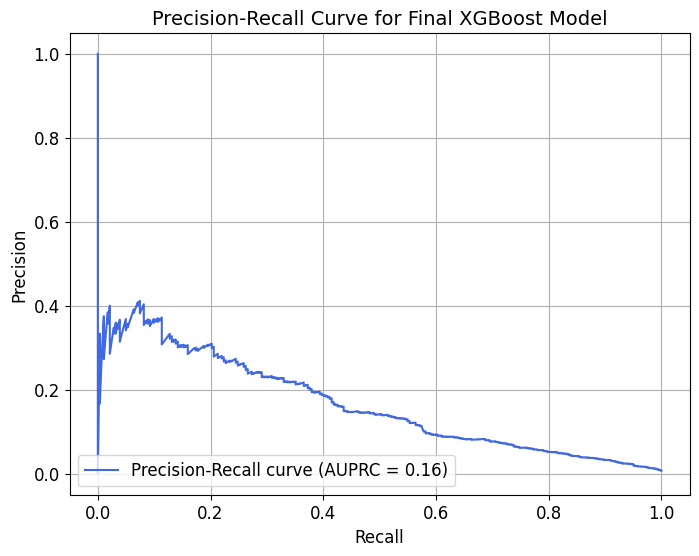

In [37]:
# Plotting Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recalls, precisions, label=f'Precision-Recall curve (AUPRC = {auprc_test:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve for Final XGBoost Model')
plt.legend(loc='lower left')
plt.grid(True)
plt.show()

In [39]:
# Find and evaluate metrics at different thresholds
thresholds_to_evaluate = np.arange(0.1, 1.0, 0.05) # Example range, adjust as needed

print("\n--- Metrics at Different Thresholds (Test Set) ---")
for th in thresholds_to_evaluate:
    y_pred_at_threshold = (y_pred_proba_test >= th).astype(int)
    report = classification_report(y_test, y_pred_at_threshold, output_dict=True, zero_division=0)

    p = report['1']['precision'] if '1' in report else 0.0
    r = report['1']['recall'] if '1' in report else 0.0
    f1 = report['1']['f1-score'] if '1' in report else 0.0

    print(f"Threshold: {th:.2f} | Precision: {p:.4f} | Recall: {r:.4f} | F1-Score: {f1:.4f}")


--- Metrics at Different Thresholds (Test Set) ---
Threshold: 0.10 | Precision: 0.0439 | Recall: 0.8404 | F1-Score: 0.0834
Threshold: 0.15 | Precision: 0.0516 | Recall: 0.8050 | F1-Score: 0.0971
Threshold: 0.20 | Precision: 0.0577 | Recall: 0.7801 | F1-Score: 0.1074
Threshold: 0.25 | Precision: 0.0626 | Recall: 0.7482 | F1-Score: 0.1155
Threshold: 0.30 | Precision: 0.0695 | Recall: 0.7340 | F1-Score: 0.1270
Threshold: 0.35 | Precision: 0.0752 | Recall: 0.7092 | F1-Score: 0.1360
Threshold: 0.40 | Precision: 0.0820 | Recall: 0.6844 | F1-Score: 0.1465
Threshold: 0.45 | Precision: 0.0841 | Recall: 0.6418 | F1-Score: 0.1487
Threshold: 0.50 | Precision: 0.0899 | Recall: 0.6099 | F1-Score: 0.1566
Threshold: 0.55 | Precision: 0.0973 | Recall: 0.5816 | F1-Score: 0.1667
Threshold: 0.60 | Precision: 0.1183 | Recall: 0.5638 | F1-Score: 0.1956
Threshold: 0.65 | Precision: 0.1309 | Recall: 0.5426 | F1-Score: 0.2109
Threshold: 0.70 | Precision: 0.1405 | Recall: 0.5035 | F1-Score: 0.2196
Threshold: 0

# **Step 13: Final Model Evaluation On Test Set**


--- Final Model Evaluation on Test Set (using Optimal Threshold) ---
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96     38317
           1       0.07      0.73      0.13       282

    accuracy                           0.93     38599
   macro avg       0.53      0.83      0.54     38599
weighted avg       0.99      0.93      0.96     38599


Confusion Matrix:
[[35545  2772]
 [   75   207]]


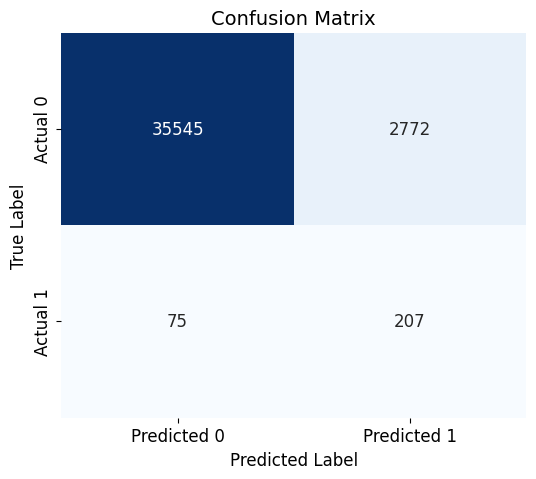

In [43]:
optimal_threshold = 0.3
y_pred_test_final = (y_pred_proba_test >= optimal_threshold).astype(int)

print("\n--- Final Model Evaluation on Test Set (using Optimal Threshold) ---")
print("Classification Report:")
print(classification_report(y_test, y_pred_test_final, zero_division=0))

cm = confusion_matrix(y_test, y_pred_test_final)
print("\nConfusion Matrix:")
print(cm)

# Visualize Confusion Matrix
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [45]:
import joblib

model_filename = 'final_xgboost_oos.joblib'
joblib.dump(final_model, model_filename)
print(f"\nFinal model saved as {model_filename}")


Final model saved as final_xgboost_oos.joblib
